# Inventory Monitoring at Distribution Centers project using amazon bin image dataset
This notebook is the main file with the flow to resolve the problem of inventory monitoring (object counting) for bin images in distribuiton centers. This is the final project for the Udacity's AWS Machine Learning Engineer Nanodegree, to show all the concepts learned during the program applied to resolve a real world problem. In this scenario we are using CNN with transfer learning using Pytorch and AWS Sagemaker to perfom an image classification of the number of items present in an image.

**Note:** This notebook has a bunch of code and markdown cells with TODOs that you have to complete. These are meant to be helpful guidelines for you to finish your project while meeting the requirements in the project rubrics. Feel free to change the order of the TODO's and/or use more than one cell to complete all the tasks.

In [ ]:

!pip install smdebug

  Preparing metadata (setup.py) ... done
  Created wheel for pyinstrument-cext: filename=pyinstrument_cext-0.2.4-cp311-cp311-linux_x86_64.whl size=6415 sha256=74276091064c339d73cbd4865602fa3958ab3f6e2533e77189e7072876a93a3b
  Stored in directory: /home/sagemaker-user/.cache/pip/wheels/6c/d4/b3/f7bd451cdb774b086ee5c4791eff9a667fb197759f2f691f66
Successfully built pyinstrument-cext
  Attempting uninstall: protobuf
    Found existing installation: protobuf 4.25.3
    Uninstalling protobuf-4.25.3:
      Successfully uninstalled protobuf-4.25.3


In [ ]:

import json
import pandas as pd
import sagemaker

## Data Preparation
**TODO:** Run the cell below to download the data.

The cell below creates a folder called `train_data`, downloads training data and arranges it in subfolders. Each of these subfolders contain images where the number of objects is equal to the name of the folder. For instance, all images in folder `1` has images with 1 object in them. Images are not divided into training, testing or validation sets. If you feel like the number of samples are not enough, you can always download more data (instructions for that can be found [here](https://registry.opendata.aws/amazon-bin-imagery/)). However, we are not acessing you on the accuracy of your final trained model, but how you create your machine learning engineering pipeline.

In [6]:
!aws s3 ls --no-sign-request s3://aft-vbi-pds/

                           PRE bin-images/
                           PRE metadata/
2017-01-16 20:10:34      22309 LICENSE
2016-06-25 22:17:05        184 NOTICE
2016-06-24 04:56:47       3976 index.html


In [ ]:
!aws s3 ls --no-sign-request s3://aft-vbi-pds/metadata/ --summarize

2016-06-22 03:27:38          0 
2017-01-14 00:06:53       2472 00001.json
2017-01-14 00:06:53       2195 00002.json
2017-01-14 00:06:53       2195 00003.json
2017-01-14 00:06:53       2087 00004.json
2017-01-14 00:06:53       1390 00005.json
2017-01-14 00:06:53       1548 00006.json
2017-01-14 00:06:53        902 00007.json
2017-01-14 00:06:53       1594 00008.json
2017-01-14 00:06:53        725 00009.json
2017-01-14 00:06:53       1516 00010.json
2017-01-14 00:06:53       3266 00011.json
2017-01-14 00:06:53       2239 00012.json
2017-01-14 00:06:53         56 00013.json
2017-01-14 00:06:53        743 00014.json
2017-01-14 00:06:53       1555 00015.json
2017-01-14 00:06:53       1555 00016.json
2017-01-14 00:06:53       1554 00017.json
2017-01-14 00:06:53       3565 00018.json
2017-01-14 00:06:53       2052 00019.json
2017-01-14 00:06:53       2424 00020.json
2017-01-14 00:06:53       3234 00021.json
2017-01-14 00:06:53       3079 00022.json
2017-01-14 00:06:53       3944 00023.json
20

2017-01-14 00:10:20       1585 100347.json
2017-01-14 00:10:20        808 100348.json
2017-01-14 00:10:20        878 100349.json
2017-01-14 00:10:20       1393 10035.json
2017-01-14 00:10:20       1479 100350.json
2017-01-14 00:10:20        738 100351.json
2017-01-14 00:10:20       3059 100352.json
2017-01-14 00:10:20       4082 100353.json
2017-01-14 00:10:20       3311 100354.json
2017-01-14 00:10:20        823 100355.json
2017-01-14 00:10:20        823 100356.json
2017-01-14 00:10:20       2122 100357.json
2017-01-14 00:10:20       2163 100358.json
2017-01-14 00:10:20       1494 100359.json
2017-01-14 00:10:20        764 10036.json
2017-01-14 00:10:20       2841 100360.json
2017-01-14 00:10:20        736 100361.json
2017-01-14 00:10:20       1445 100362.json
2017-01-14 00:10:20       1733 100363.json
2017-01-14 00:10:20       2058 100364.json
2017-01-14 00:10:20       2110 100365.json
2017-01-14 00:10:20       2771 100366.json
2017-01-14 00:10:20        719 100367.json
2017-01-14 00

In [1]:
!aws s3 cp --no-sign-request s3://aft-vbi-pds/metadata/1.json -

{
    "BIN_FCSKU_DATA": {},
    "EXPECTED_QUANTITY": 0,
    "image_fname": "1.jpg"
}


As we can see there are 536435 total files in this dataset, but we are going to use only a subset, the images present in the file_list.json. Let's explore this dataset to perform an EDA. Also we known the structure of the json metadata files, for this problem we only need the "image_fname" and "expected_quantity" fields.

In [34]:
json_file_path = "file_list.json"

with open(json_file_path, 'r') as j:
     item_dict = json.loads(j.read())
print(len(item_dict))    
print(len(item_dict["1"]))
print(len(item_dict["2"]))
print(len(item_dict["3"]))
print(len(item_dict["4"]))
print(len(item_dict["5"]))


5
1228
2299
2666
2373
1875


This subset is split in 5 different categories corresponding to the image classification according to the number of items in the bin present in the image. The following steps are to prepare the files with the splits for every category for train, validation and test sets with a 80%, 10% and 10% distribution each. After that we can take a look at the train dataset histogram and download the sets and upload them to s3 for training

In [35]:
train = {}
valid = {}
test = {}

for k, v in item_dict.items():
    size = len(v)
    print("%s has %d items" % (k, size))
    i = (int)(0.8 * size)
    j = (int)(0.9 * size)
    train[k] = v[:i]
    valid[k] = v[i:j]
    test[k] = v[j:]
    print("%s:%s:%s" % (len(train[k]), len(valid[k]), len(test[k])))

with open('train.json', 'w') as f:
        json.dump(train, f)
with open('valid.json', 'w') as f:
        json.dump(valid, f)
with open('test.json', 'w') as f:
        json.dump(test, f)


1 has 1228 items
982:123:123
2 has 2299 items
1839:230:230
3 has 2666 items
2132:267:267
4 has 2373 items
1898:237:238
5 has 1875 items
1500:187:188


In [40]:
with open("train.json", 'r') as j:
    train_dict = json.loads(j.read())

filenames = []
count = []
for k, v in train_dict.items():
    for i in range(len(v)):
        filenames.append(v[i])
        count.append(int(k))

df = pd.DataFrame({"filename": filenames, "count": count})

In [41]:
df.head()

,filename,count
0,data/metadata/100313.json,1
1,data/metadata/09915.json,1
2,data/metadata/103299.json,1
3,data/metadata/00710.json,1
4,data/metadata/05397.json,1


In [42]:
df.describe()

,count
count,8351.000000
mean,3.131122
std,1.272530
min,1.000000
25%,2.000000
50%,3.000000
75%,4.000000
max,5.000000


array([[<Axes: title={'center': 'count'}>]], dtype=object)

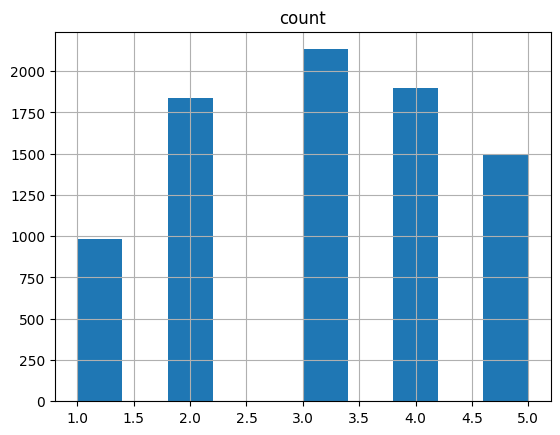

In [43]:
df.hist()

As we can see this is pretty valid dataset to perform the training, with a standard Gaussian distribution, and there are only 5 categories (no zero count cases and either more than 5 count cases), and we already know for the papers read during the proposal phase, the complecity to resolve the problem for this dataset can be considered a "moderated" task, and we can obtain a pretty good accuracy for the model without having to perform additional procedures

In [1]:
import os
import json
import boto3
from botocore import UNSIGNED
from botocore.client import Config
from tqdm import tqdm

def download_and_arrange_data(data_dir: str):
    s3_client = boto3.client('s3', config=Config(signature_version=UNSIGNED), region_name='us-east-1')

    with open(f"{data_dir}.json", 'r') as f:
        d=json.load(f)

    for k, v in d.items():
        print(f"Downloading Images with {k} objects")
        directory=os.path.join(data_dir, k)
        if not os.path.exists(directory):
            os.makedirs(directory)
        for file_path in tqdm(v):
            file_name=os.path.basename(file_path).split('.')[0]+'.jpg'
            s3_client.download_file('aft-vbi-pds', os.path.join('bin-images', file_name),
                             os.path.join(directory, file_name))

download_and_arrange_data('train')
download_and_arrange_data('valid')
download_and_arrange_data('test')

100%|██████████| 982/982 [01:27<00:00, 11.23it/s]


100%|██████████| 1839/1839 [02:49<00:00, 10.85it/s]


100%|██████████| 2132/2132 [03:21<00:00, 10.60it/s]


100%|██████████| 1898/1898 [02:52<00:00, 10.97it/s]


100%|██████████| 1500/1500 [02:14<00:00, 11.16it/s]


100%|██████████| 123/123 [00:10<00:00, 11.64it/s]


100%|██████████| 230/230 [00:21<00:00, 10.53it/s]


100%|██████████| 267/267 [00:25<00:00, 10.61it/s]


100%|██████████| 237/237 [00:23<00:00, 10.06it/s]


100%|██████████| 187/187 [00:16<00:00, 11.32it/s]


100%|██████████| 123/123 [00:10<00:00, 11.85it/s]


100%|██████████| 230/230 [00:20<00:00, 11.02it/s]


100%|██████████| 267/267 [00:24<00:00, 10.97it/s]


100%|██████████| 238/238 [00:22<00:00, 10.81it/s]


100%|██████████| 188/188 [00:16<00:00, 11.67it/s]


## Dataset
**TODO:** Explain what dataset you are using for this project. Give a small overview of the classes, class distributions etc that can help anyone not familiar with the dataset get a better understanding of it. You can find more information about the data [here](https://registry.opendata.aws/amazon-bin-imagery/).

In [4]:
sagemaker_session = sagemaker.Session()
bucket = sagemaker_session.default_bucket()
prefix = "bin-images"
role = sagemaker.get_execution_role()

In [13]:
!mkdir "data"
!cp -r "./train" "./data"
!cp -r "./valid" "./data"
!cp -r "./test" "./data"

In [14]:
sagemaker_session.upload_data(path="./data", bucket=bucket, key_prefix=prefix)

's3://sagemaker-us-east-1-887774847132/bin-images'

In [5]:
data_dir = f's3://{bucket}/{prefix}'
print(data_dir)

s3://sagemaker-us-east-1-887774847132/bin-images


In [3]:
import shutil
shutil.make_archive("data", "zip", "./data")

'/home/sagemaker-user/data.zip'

## Model Training
**TODO:** This is the part where you can train a model. The type or architecture of the model you use is not important. 

**Note:** You will need to use the `train.py` script to train your model.

### Hyperparameter Tuning
**TODO:** Here you can perform hyperparameter tuning to increase the performance of your model. You are encouraged to 
- tune as many hyperparameters as you can to get the best performance from your model
- explain why you chose to tune those particular hyperparameters and the ranges.


In [ ]:
# here I'm following the values and hyperparameters described as the best to fit this problem in the report found in
# in https://github.com/pablo-tech/Image-Inventory-Reconciliation-with-SVM-and-CNN/blob/master/ProjectReport.pdf to obtain best results
from sagemaker.tuner import (
    IntegerParameter,
    CategoricalParameter,
    ContinuousParameter,
    HyperparameterTuner,
)
hyperparameter_ranges = {
    "lr": ContinuousParameter(0.001, 0.1),
    "batch-size": CategoricalParameter([128, 256, 512]),
    "epochs": IntegerParameter(8, 11)
}
objective_metric_name = "average test loss"
objective_type = "Minimize"
metric_definitions = [{"Name": "average test loss", "Regex": "Testing Loss: ([0-9\\.]+)"}]

In [ ]:

from sagemaker.pytorch import PyTorch

estimator = PyTorch(
    entry_point="hpo.py",
    role=role,
    py_version='py38',
    framework_version="1.12",
    instance_count=1,
    instance_type="ml.g4dn.xlarge",
)

tuner = HyperparameterTuner(
    estimator,
    objective_metric_name,
    hyperparameter_ranges,
    metric_definitions,
    max_jobs=8,
    max_parallel_jobs=2,
    objective_type=objective_type,
)

In [ ]:

tuner.fit(inputs=data_dir, wait=True)

No finished training job found associated with this estimator. Please make sure this estimator is only used for building workflow config
No finished training job found associated with this estimator. Please make sure this estimator is only used for building workflow config


...................................................................................................................................................................................................................................................................................................................................................................................................................................................................!


In [ ]:

best_estimator = tuner.best_estimator()

#Get the hyperparameters of the best trained model
best_estimator.hyperparameters()


2024-11-20 18:58:46 Starting - Found matching resource for reuse
2024-11-20 18:58:46 Downloading - Downloading the training image
2024-11-20 18:58:46 Training - Training image download completed. Training in progress.
2024-11-20 18:58:46 Uploading - Uploading generated training model
2024-11-20 18:58:46 Completed - Resource reused by training job: pytorch-training-241120-1832-008-f027cafc


{'_tuning_objective_metric': '"average test loss"',
 'batch-size': '"512"',
 'epochs': '11',
 'lr': '0.005676229610127364',
 'sagemaker_container_log_level': '20',
 'sagemaker_estimator_class_name': '"PyTorch"',
 'sagemaker_estimator_module': '"sagemaker.pytorch.estimator"',
 'sagemaker_job_name': '"pytorch-training-2024-11-20-18-32-46-459"',
 'sagemaker_program': '"hpo.py"',
 'sagemaker_region': '"us-east-1"',
 'sagemaker_submit_directory': '"s3://sagemaker-us-east-1-887774847132/pytorch-training-2024-11-20-18-32-46-459/source/sourcedir.tar.gz"'}

### Model Profiling and Debugging
**TODO:** Use model debugging and profiling to better monitor and debug your model training job.

In [ ]:

from sagemaker.debugger import (
    Rule,
    DebuggerHookConfig,
    ProfilerRule,
    rule_configs,
    ProfilerConfig,
    FrameworkProfile,
    CollectionConfig
)

rules = [
    Rule.sagemaker(rule_configs.vanishing_gradient()),
    Rule.sagemaker(rule_configs.overfit()),
    Rule.sagemaker(rule_configs.overtraining()),
    Rule.sagemaker(rule_configs.poor_weight_initialization()),
    Rule.sagemaker(rule_configs.loss_not_decreasing()),
    ProfilerRule.sagemaker(rule_configs.LowGPUUtilization()),
    ProfilerRule.sagemaker(rule_configs.ProfilerReport()),
]
#Reference: https://knowledge.udacity.com/questions/749611
collection_configs = [CollectionConfig(name="CrossEntropyLoss_output_0", parameters={
    "include_regex": "CrossEntropyLoss_output_0", "train.save_interval": "100", "eval.save_interval": "10"})]

hook_config = DebuggerHookConfig(
    collection_configs=collection_configs
)
profiler_config = ProfilerConfig(
    system_monitor_interval_millis=500, framework_profile_params=FrameworkProfile(num_steps=10)
)

Framework profiling will be deprecated from tensorflow 2.12 and pytorch 2.0 in sagemaker>=2.
See: https://sagemaker.readthedocs.io/en/stable/v2.html for details.


In [ ]:

hyperparameters = {"epochs": "11", "batch-size": "512", "lr": "0.005676229610127364"}

estimator = PyTorch(
    entry_point="train.py",
    base_job_name="smdebugger-inventory-project-pytorch",
    role=role,
    instance_count=2, # multi-instance training for better performance
    instance_type="ml.g4dn.xlarge",
    hyperparameters=hyperparameters,
    framework_version="1.12",
    py_version="py38",
    ## Debugger parameters
    rules=rules,
    debugger_hook_config=hook_config,
    profiler_config=profiler_config,
)

In [12]:
estimator.fit(inputs=data_dir, wait=True)

INFO:sagemaker.image_uris:image_uri is not presented, retrieving image_uri based on instance_type, framework etc.
INFO:sagemaker:Creating training-job with name: smdebugger-inventory-project-pytorch-2024-11-20-19-13-32-251


2024-11-20 19:13:35 Starting - Starting the training job...
2024-11-20 19:14:07 Starting - Preparing the instances for trainingVanishingGradient: InProgress
Overfit: InProgress
Overtraining: InProgress
PoorWeightInitialization: InProgress
LossNotDecreasing: InProgress
LowGPUUtilization: InProgress
ProfilerReport: InProgress
...
2024-11-20 19:14:38 Downloading - Downloading input data......
2024-11-20 19:15:39 Downloading - Downloading the training image........................
2024-11-20 19:19:40 Training - Training image download completed. Training in progress.bash: cannot set terminal process group (-1): Inappropriate ioctl for device
bash: no job control in this shell
2024-11-20 19:19:27,901 sagemaker-training-toolkit INFO     Imported framework sagemaker_pytorch_container.training
2024-11-20 19:19:27,923 sagemaker-training-toolkit INFO     No Neurons detected (normal if no neurons installed)
2024-11-20 19:19:27,934 sagemaker_pytorch_container.training INFO     Block until all host

In [ ]:

import smdebug
from smdebug.trials import create_trial
from smdebug.core.modes import ModeKeys

trial = create_trial(estimator.latest_job_debugger_artifacts_path())

[2024-11-20 19:31:10.683 default:114 INFO utils.py:28] RULE_JOB_STOP_SIGNAL_FILENAME: None
[2024-11-20 19:31:10.700 default:114 INFO s3_trial.py:42] Loading trial debug-output at path s3://sagemaker-us-east-1-887774847132/smdebugger-inventory-project-pytorch-2024-11-20-19-13-32-251/debug-output


In [16]:
trial.tensor_names()

[2024-11-20 19:31:11.311 default:114 INFO trial.py:197] Training has ended, will refresh one final time in 1 sec.
[2024-11-20 19:31:12.326 default:114 INFO trial.py:210] Loaded all steps


['CrossEntropyLoss_output_0',
 'gradient/EfficientNet_classifier.1.1.bias',
 'gradient/EfficientNet_classifier.1.1.weight']

In [17]:
len(trial.tensor("CrossEntropyLoss_output_0").steps(mode=ModeKeys.TRAIN))

2

In [18]:
len(trial.tensor("CrossEntropyLoss_output_0").steps(mode=ModeKeys.EVAL))

3

In [19]:
def get_data(trial, tname, mode):
    tensor = trial.tensor(tname)
    steps = tensor.steps(mode=mode)
    vals = []
    for s in steps:
        vals.append(tensor.value(s, mode=mode))
    return steps, vals

In [20]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import host_subplot


def plot_tensor(trial, tensor_name):

    steps_train, vals_train = get_data(trial, tensor_name, mode=ModeKeys.TRAIN)
    print("loaded TRAIN data")
    steps_eval, vals_eval = get_data(trial, tensor_name, mode=ModeKeys.EVAL)
    print("loaded EVAL data")

    fig = plt.figure(figsize=(10, 7))
    host = host_subplot(111)

    par = host.twiny()

    host.set_xlabel("Steps (TRAIN)")
    par.set_xlabel("Steps (EVAL)")
    host.set_ylabel(tensor_name)

    (p1,) = host.plot(steps_train, vals_train, label=tensor_name)
    print("completed TRAIN plot")
    (p2,) = par.plot(steps_eval, vals_eval, label="val_" + tensor_name)
    print("completed EVAL plot")
    leg = plt.legend()

    host.xaxis.get_label().set_color(p1.get_color())
    leg.texts[0].set_color(p1.get_color())

    par.xaxis.get_label().set_color(p2.get_color())
    leg.texts[1].set_color(p2.get_color())

    plt.ylabel(tensor_name)

    plt.show()

INFO:matplotlib.font_manager:generated new fontManager


loaded TRAIN data
loaded EVAL data
completed TRAIN plot
completed EVAL plot


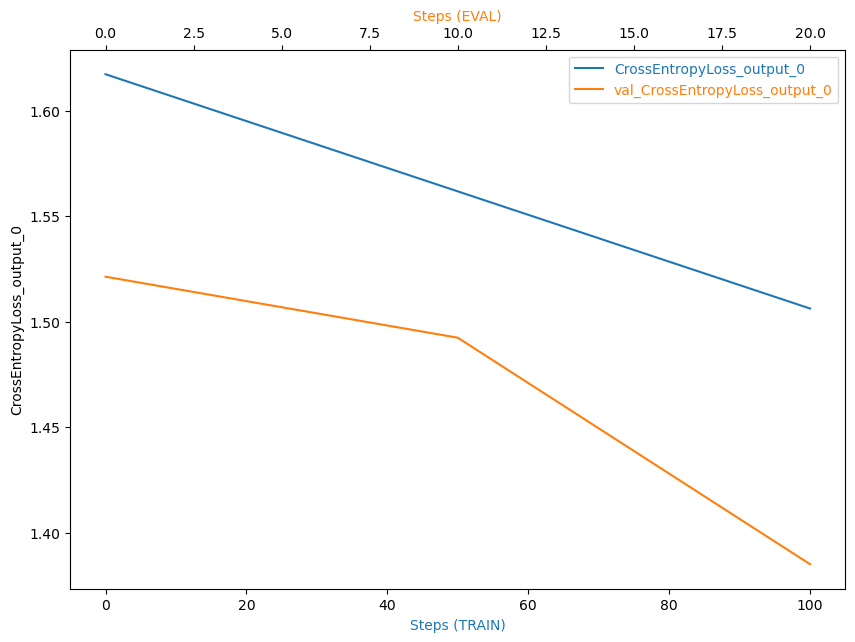

In [21]:
plot_tensor(trial, "CrossEntropyLoss_output_0")

**TODO**: Is there some anomalous behaviour in your debugging output? If so, what is the error and how will you fix it?  
**TODO**: If not, suppose there was an error. What would that error look like and how would you have fixed it?

In [ ]:

rule_output_path = estimator.output_path + estimator.latest_training_job.job_name + "/rule-output"

In [23]:
! aws s3 ls {rule_output_path} --recursive

2024-11-20 19:29:02     434555 smdebugger-inventory-project-pytorch-2024-11-20-19-13-32-251/rule-output/ProfilerReport/profiler-output/profiler-report.html
2024-11-20 19:29:01     294319 smdebugger-inventory-project-pytorch-2024-11-20-19-13-32-251/rule-output/ProfilerReport/profiler-output/profiler-report.ipynb
2024-11-20 19:28:57        539 smdebugger-inventory-project-pytorch-2024-11-20-19-13-32-251/rule-output/ProfilerReport/profiler-output/profiler-reports/BatchSize.json
2024-11-20 19:28:57      36735 smdebugger-inventory-project-pytorch-2024-11-20-19-13-32-251/rule-output/ProfilerReport/profiler-output/profiler-reports/CPUBottleneck.json
2024-11-20 19:28:57       2228 smdebugger-inventory-project-pytorch-2024-11-20-19-13-32-251/rule-output/ProfilerReport/profiler-output/profiler-reports/Dataloader.json
2024-11-20 19:28:57        492 smdebugger-inventory-project-pytorch-2024-11-20-19-13-32-251/rule-output/ProfilerReport/profiler-output/profiler-reports/GPUMemoryIncrease.json
2024-1

In [24]:
! aws s3 cp {rule_output_path} ./ --recursive

download: s3://sagemaker-us-east-1-887774847132/smdebugger-inventory-project-pytorch-2024-11-20-19-13-32-251/rule-output/ProfilerReport/profiler-output/profiler-reports/BatchSize.json to ProfilerReport/profiler-output/profiler-reports/BatchSize.json
download: s3://sagemaker-us-east-1-887774847132/smdebugger-inventory-project-pytorch-2024-11-20-19-13-32-251/rule-output/ProfilerReport/profiler-output/profiler-reports/CPUBottleneck.json to ProfilerReport/profiler-output/profiler-reports/CPUBottleneck.json
download: s3://sagemaker-us-east-1-887774847132/smdebugger-inventory-project-pytorch-2024-11-20-19-13-32-251/rule-output/ProfilerReport/profiler-output/profiler-reports/StepOutlier.json to ProfilerReport/profiler-output/profiler-reports/StepOutlier.json
download: s3://sagemaker-us-east-1-887774847132/smdebugger-inventory-project-pytorch-2024-11-20-19-13-32-251/rule-output/ProfilerReport/profiler-output/profiler-reports/OverallFrameworkMetrics.json to ProfilerReport/profiler-output/profil

In [25]:
import os

# get the autogenerated folder name of profiler report
profiler_report_name = [
    rule["RuleConfigurationName"]
    for rule in estimator.latest_training_job.rule_job_summary()
    if "Profiler" in rule["RuleConfigurationName"]
][0]

In [1]:
import IPython

IPython.display.HTML(filename="./ProfilerReport/profiler-output/profiler-report.html")

### Model Deploying and Querying
**TODO:** Can you deploy your model to an endpoint and then query that endpoint to get a result?

In [27]:
estimator.model_data

's3://sagemaker-us-east-1-887774847132/smdebugger-inventory-project-pytorch-2024-11-20-19-13-32-251/output/model.tar.gz'

In [ ]:

from sagemaker.pytorch import PyTorchModel
from sagemaker.serializers import IdentitySerializer
from sagemaker.deserializers import JSONDeserializer

pytorch_model = PyTorchModel(model_data=estimator.model_data, 
                             role=role,
                             py_version='py38',
                             framework_version='1.12',
                             entry_point='inference.py',
                             )
deployment = pytorch_model.deploy(initial_instance_count=1, instance_type='ml.m5.large', serializer=IdentitySerializer("image/jpeg"), deserializer=JSONDeserializer())
endpoint = deployment.endpoint_name
print(endpoint)

INFO:sagemaker:Repacking model artifact (s3://sagemaker-us-east-1-887774847132/smdebugger-inventory-project-pytorch-2024-11-20-19-13-32-251/output/model.tar.gz), script artifact (None), and dependencies ([]) into single tar.gz file located at s3://sagemaker-us-east-1-887774847132/pytorch-inference-2024-11-20-19-35-33-675/model.tar.gz. This may take some time depending on model size...
INFO:sagemaker:Creating model with name: pytorch-inference-2024-11-20-19-35-41-430
INFO:sagemaker:Creating endpoint-config with name pytorch-inference-2024-11-20-19-35-42-174
INFO:sagemaker:Creating endpoint with name pytorch-inference-2024-11-20-19-35-42-174


--

In [ ]:

with open("./data/test/3/01392.jpg", "rb") as f:
    payload = f.read()

inference = deployment.predict(payload)
print(inference)

[[-0.427242249250412, 0.08517174422740936, 0.23597148060798645, -0.11403524875640869, -0.11748440563678741]]


In [32]:
import numpy as np 
np.argmax(inference)+1

3

In [ ]:

deployment.delete_endpoint()

INFO:sagemaker:Deleting endpoint configuration with name: pytorch-inference-2024-11-20-19-35-42-174
INFO:sagemaker:Deleting endpoint with name: pytorch-inference-2024-11-20-19-35-42-174


In [34]:
import shutil

shutil.make_archive("ProfilerReport", 'zip', "./ProfilerReport")

'/home/sagemaker-user/ProfilerReport.zip'